<h1><center>2021 BRFSS Data: Part 2</center></h1>


#### About the data:
- The dataset used in this project is the 2021 BRFSS Data.
- The Behavioral Risk Factor Surveillance System (BRFSS) is a collaborative project between all the states in the United States and participating US territories and the Centers for Disease Control and Prevention (CDC).
- It is used to collect prevalence data among adult U.S. residents regarding their risk behaviors and preventive health practices that can affect their health status. Respondent data are forwarded to CDC to be aggregated for each state, returned with standard tabulations, and published at year's end by each state. 
- To get the database used, __[Click Here](https://www.cdc.gov/brfss/annual_data/annual_2021.html)__
- For the codebook of the database, __[Click Here](https://www.cdc.gov/brfss/annual_data/2021/pdf/codebook21_llcp-v2-508.pdf)__


#### The project is:
- __Part 1. Preparing:__ In this part, I will choose what columns will be left to analyze, change the values in them to more human-readable form according the the BRFSS codebook.<br>
- __Part 2. EDA:__ In this part, I will do some exploratory data analysis, trying to find insights from the data.<br>
- __Part 3. Statistics:__ In this part, I will do some statistical hypotheses testing to evaluate some of the insights found in part 2, I will also conduct regression analysis.

In [1]:
# Import the packages that will be needed in this analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Define some setting
pd.set_option('display.max_columns', None)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams["figure.figsize"] = (10,8)
plt.rcParams['axes.titlesize'] = 18

# Import the datafame
df = pd.read_csv('LLCP2021_Prepared.csv')

In [2]:
diseases = ['HTN', 'DM', 'Asthma', 'COPD', 'Arthritis', 'Kidney_Disease', 'Depression', 'MI', 'CHD', 'Stroke']
num_vars = [col for col in df.columns if df[col].dtypes != 'O']
cat_vars = [col for col in df.columns if (df[col].dtypes == 'O') & (col not in diseases)]
cat_cols = diseases + cat_vars

In [3]:
# Checking the data to get a better understanding for it

def inspect_df(dataframe):
    print(" Shape ".center(50, '#'), end='\n\n')
    print(f"This dataframe consists of {dataframe.shape[0]} rows and  {dataframe.shape[1]} columns.", end='\n\n\n')
    print(" Categorical Columns' Data ".center(50, '#'), end='\n\n')
    for col in cat_cols:
        print(f'"{col}" column:')
        print(f'='*(len(col)+10))
        print(f'"{col}" column has {dataframe[col].isnull().sum()} null values.')
        print(dataframe[col].value_counts(), end='\n\n\n')

inspect_df(df)

##################### Shape ######################

This dataframe consists of 419079 rows and  30 columns.


########### Categorical Columns' Data ############

"HTN" column:
"HTN" column has 1844 null values.
No     248825
Yes    168410
Name: HTN, dtype: int64


"DM" column:
"DM" column has 925 null values.
No     360911
Yes     57243
Name: DM, dtype: int64


"Asthma" column:
"Asthma" column has 1686 null values.
No     356510
Yes     60883
Name: Asthma, dtype: int64


"COPD" column:
"COPD" column has 2043 null values.
No     382947
Yes     34089
Name: COPD, dtype: int64


"Arthritis" column:
"Arthritis" column has 2831 null values.
No     276502
Yes    139746
Name: Arthritis, dtype: int64


"Kidney_Disease" column:
"Kidney_Disease" column has 1751 null values.
No     400307
Yes     17021
Name: Kidney_Disease, dtype: int64


"Depression" column:
"Depression" column has 2454 null values.
No     331993
Yes     84632
Name: Depression, dtype: int64


"MI" column:
"MI" column has 2591 nul

In [4]:
df.describe(include="object").T

,count,unique,top,freq
Urban_Rural,412033,2,Urban counties,350741
Gender,419079,2,Female,222641
Age_Category,419079,6,65 or older,150441
Education,416834,4,Graduated from College or Technical School,165979
Martial_Status,414477,6,Married,212589
Income_Category,333898,7,"$50,000 to < $100,000",103477
Veteran,416531,2,No,364648
BMI_Category,380722,4,Overweight,134026
Smoking,399881,3,Never smoked,234197
Insurance,402239,2,Yes,379332


In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Height,401584.0,170.293140,10.631788,140.500000,163.00,170.00,178.00,200.500
Weight,386935.0,83.009184,20.262220,27.225000,68.04,81.65,95.25,136.065
BMI,380722.0,28.441652,5.966126,12.720000,24.21,27.44,31.87,43.360
Alcohol_Drinks,199971.0,2.080892,1.391714,0.000000,1.00,2.00,3.00,6.000
DM_Age,52592.0,49.699859,14.550590,10.000000,40.00,50.00,60.00,90.000
BGM_Weekly,18486.0,9.783080,8.932008,0.019231,2.00,7.00,14.00,32.000
A1C,20557.0,2.521404,1.632547,0.000000,1.00,2.00,4.00,8.500
Feet_Check,21030.0,1.852544,1.699803,0.000000,1.00,1.00,3.00,6.000


In [6]:
# Creating ordered categorical columns

Age_Category_Order = ["18 to 24", "25 to 34", "35 to 44", "45 to 54", "55 to 64" , "65 or older"]
df['Age_Category'] = pd.Categorical(df['Age_Category'], Age_Category_Order, ordered=True)

Education_Order = ["Did not graduate High School", "Graduated High School", "Attended College or Technical School", "Graduated from College or Technical School"]
df['Education'] = pd.Categorical(df['Education'], Education_Order, ordered=True)

Income_Category_Order = ["0 to $15,000", "$15,000 to < $25,000", "$25,000 to < $35,000", "$35,000 to < $50,000", "$50,000 to < $100,000", "$100,000 to < $200,000", "$200,000 or more"]
df['Income_Category'] = pd.Categorical(df['Income_Category'], Income_Category_Order, ordered=True)

BMI_Category_Order = ["Underweight", "Normal Weight", "Overweight", "Obese"]
df['BMI_Category'] = pd.Categorical(df['BMI_Category'], BMI_Category_Order, ordered=True)

In [7]:
df.sample(5)

,Urban_Rural,Gender,Age_Category,Education,Martial_Status,Income_Category,Veteran,Height,Weight,BMI,BMI_Category,Smoking,Alcohol_Drinks,Insurance,HTN,MI,CHD,Stroke,DM,DM_Age,BGM_Weekly,A1C,Insulin,Retinopathy_Counseled,Feet_Check,Asthma,COPD,Arthritis,Kidney_Disease,Depression
342890,Urban counties,Female,65 or older,Graduated from College or Technical School,Married,"$200,000 or more",No,175.0,65.77,21.41,Normal Weight,Never smoked,2.0,Yes,No,No,No,No,No,NaN,NaN,NaN,NaN,NaN,NaN,No,No,No,No,No
112432,Urban counties,Female,35 to 44,Graduated from College or Technical School,Never married,"$50,000 to < $100,000",No,152.0,52.16,22.46,Normal Weight,Former smoker,4.0,Yes,No,No,No,No,No,NaN,NaN,NaN,NaN,NaN,NaN,No,No,No,No,No
346107,Urban counties,Female,35 to 44,Attended College or Technical School,Widowed,"$15,000 to < $25,000",No,168.0,65.77,23.40,Normal Weight,Never smoked,1.0,Yes,No,No,No,No,No,NaN,NaN,NaN,NaN,NaN,NaN,No,No,No,No,No
133131,Urban counties,Male,55 to 64,Graduated from College or Technical School,Married,"$100,000 to < $200,000",No,180.0,74.84,23.01,Normal Weight,Never smoked,1.0,Yes,No,No,No,No,No,NaN,NaN,NaN,NaN,NaN,NaN,No,No,No,No,No
265776,Urban counties,Female,35 to 44,Graduated High School,Separated,NaN,No,168.0,53.98,19.21,Normal Weight,Never smoked,2.0,Yes,No,No,No,No,No,NaN,NaN,NaN,NaN,NaN,NaN,No,No,No,No,No


## Beginning of the EDA

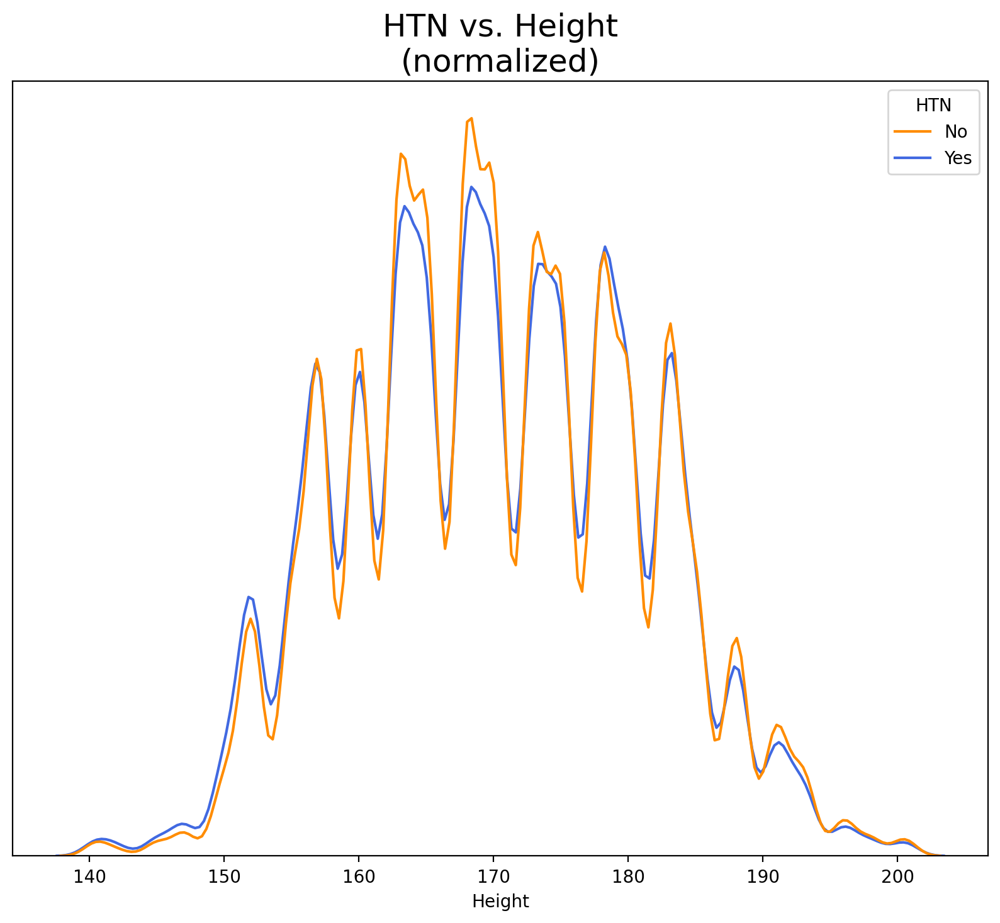

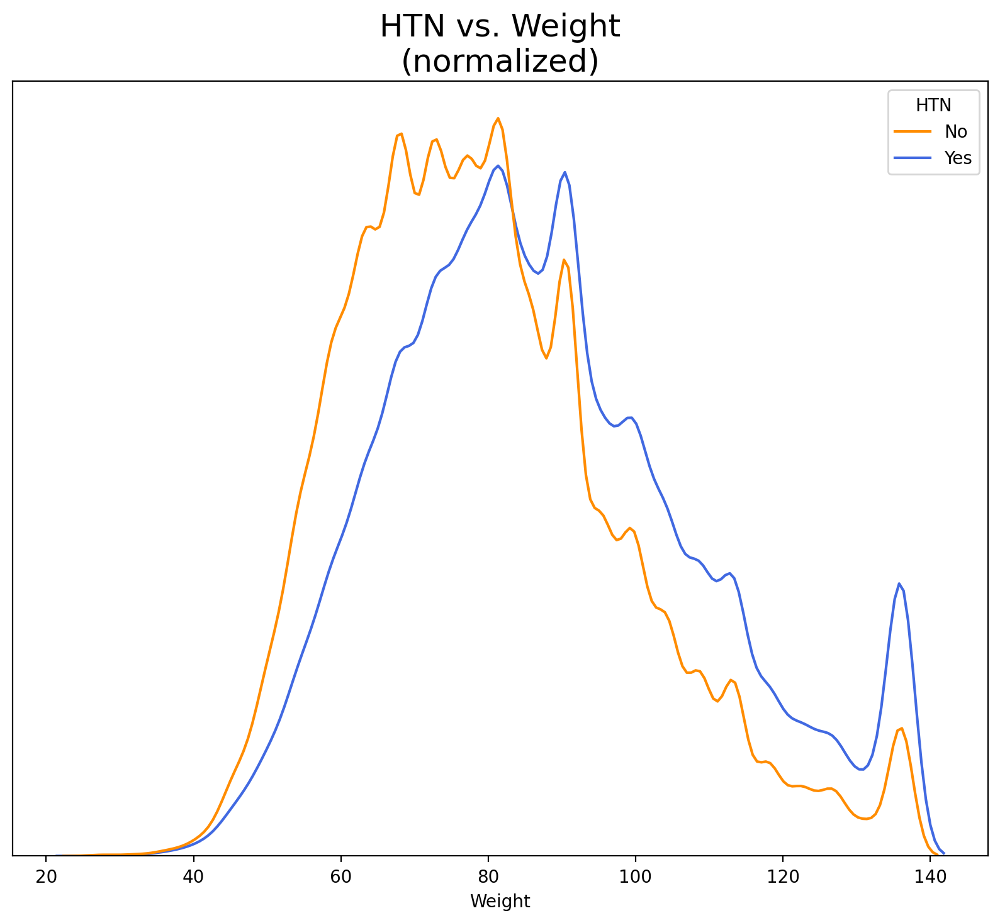

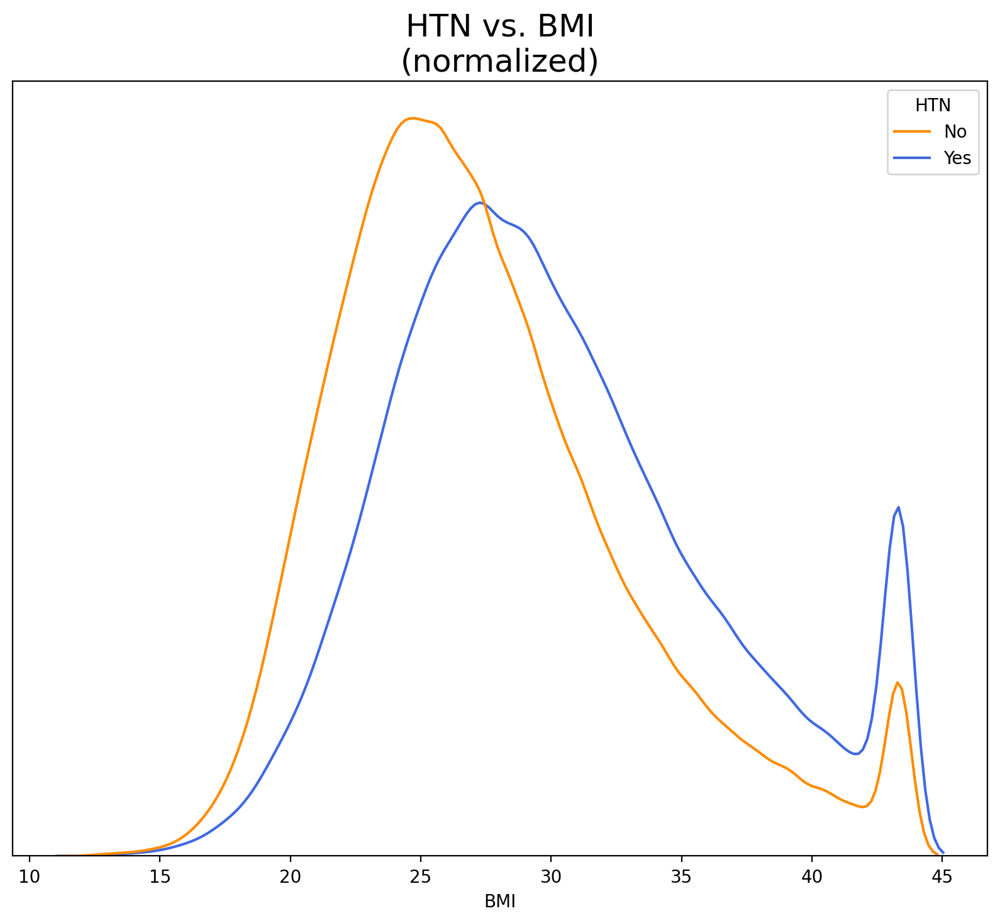

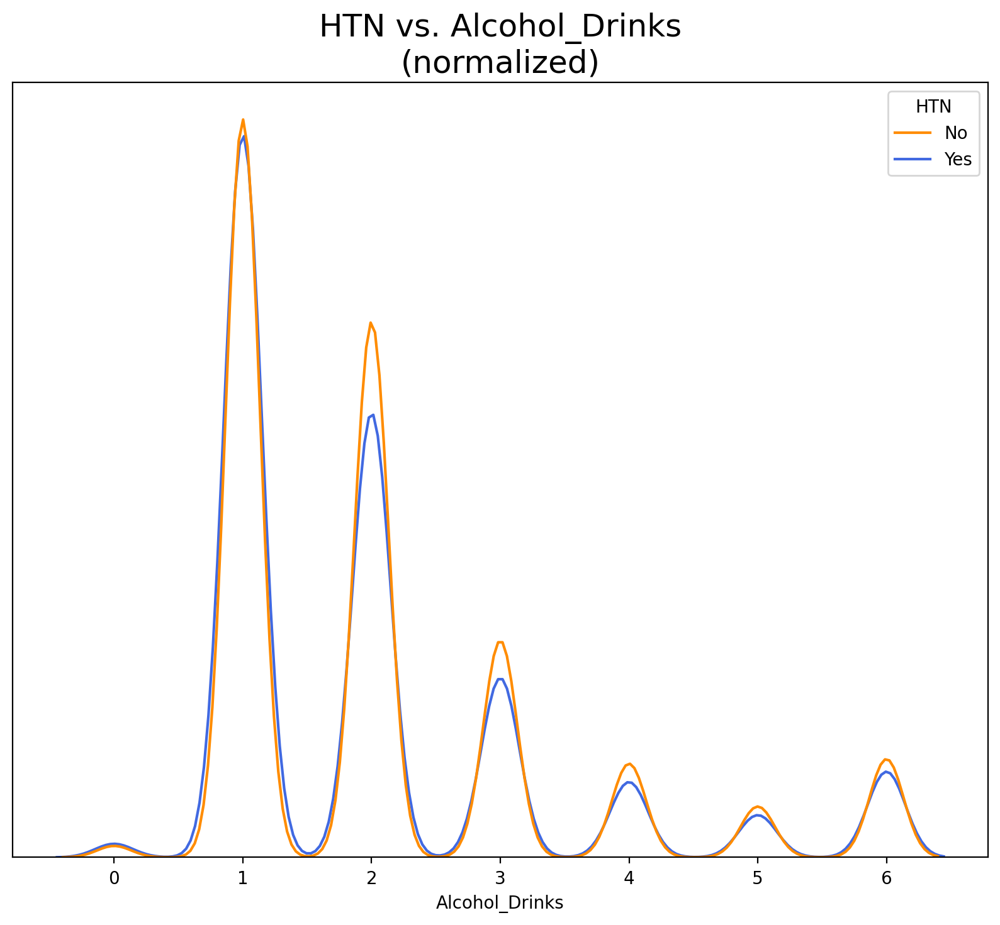

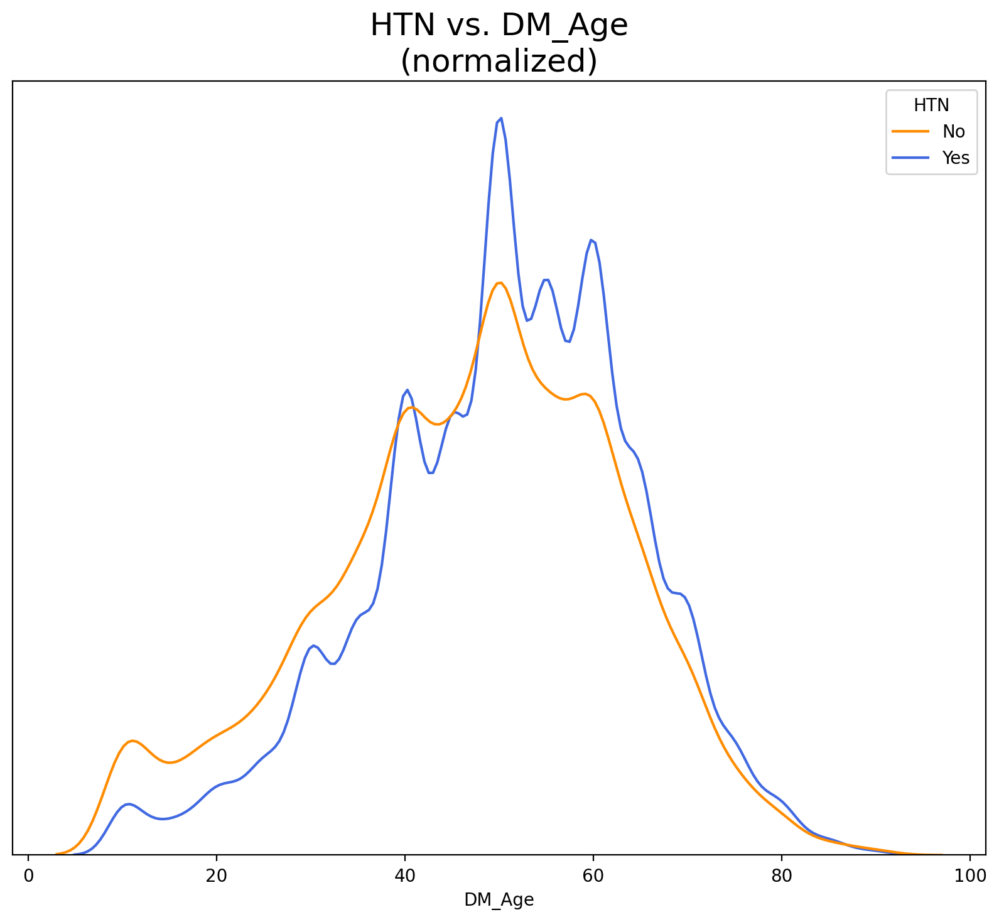

...

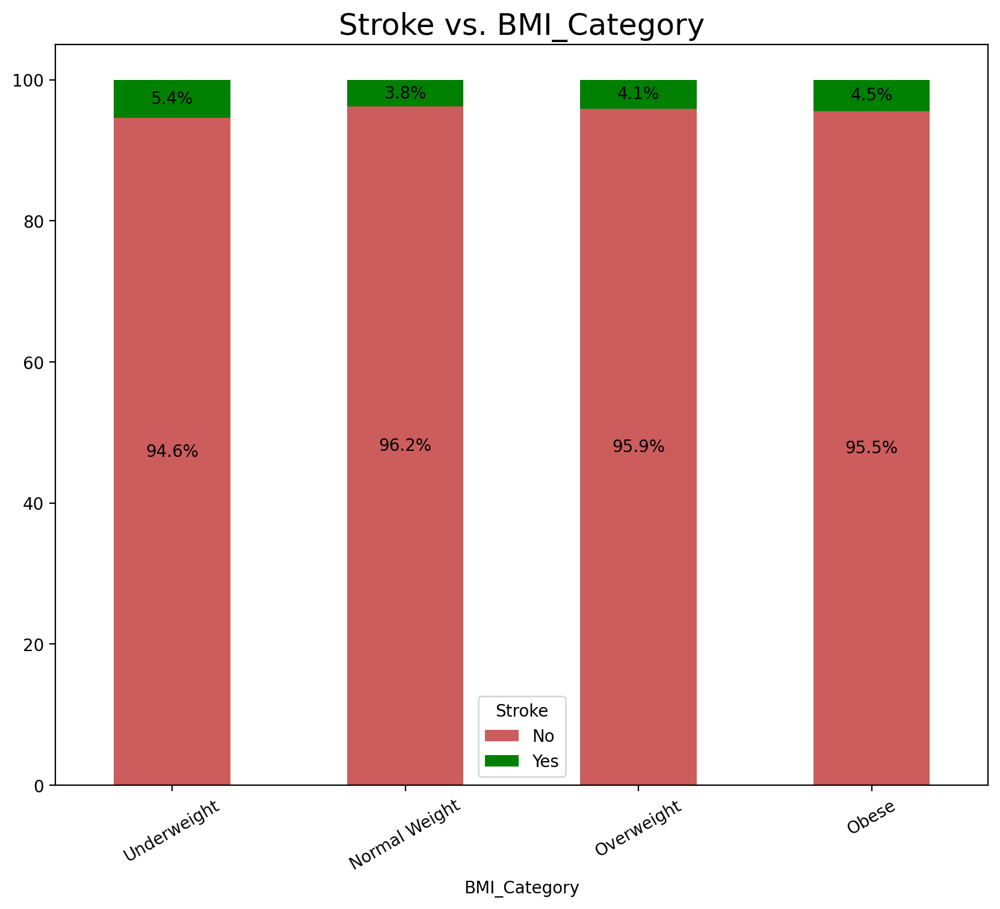

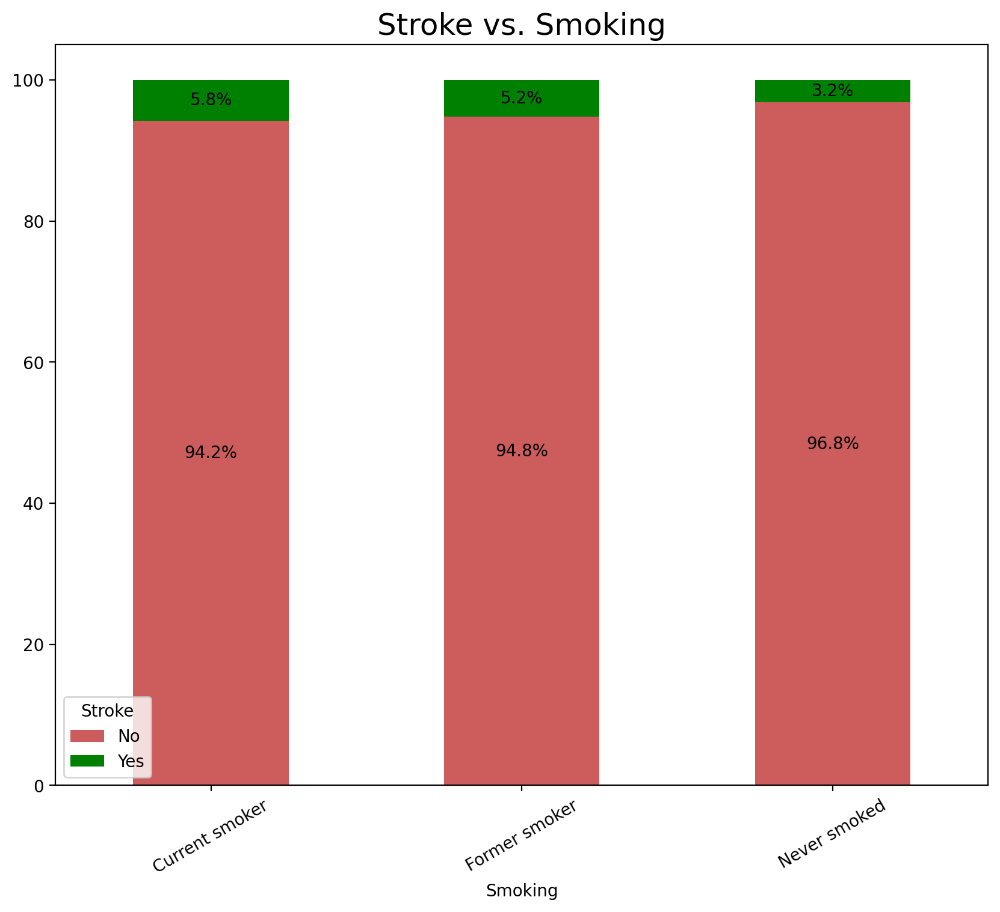

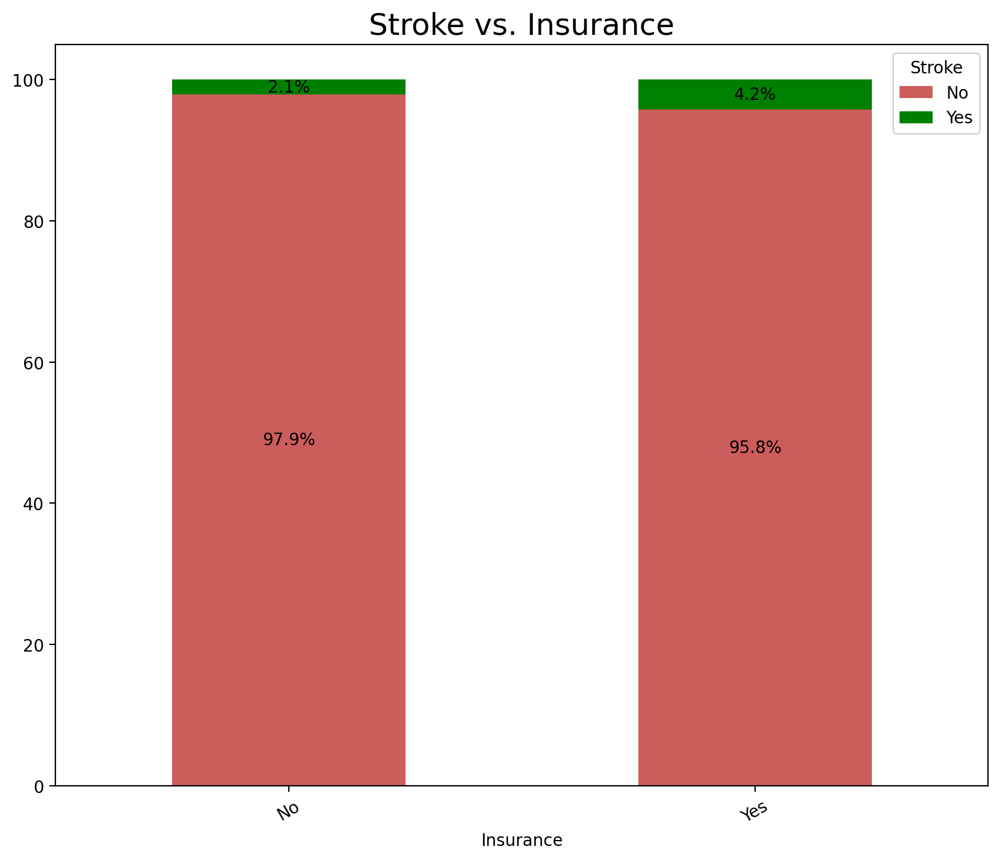

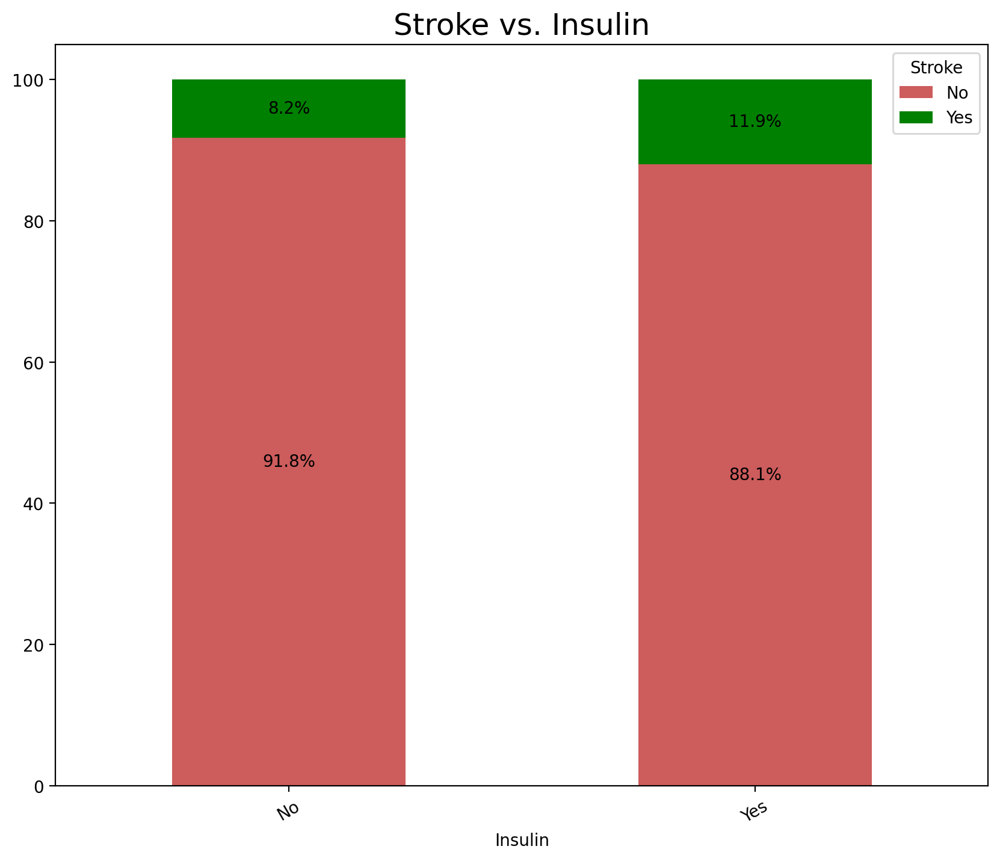

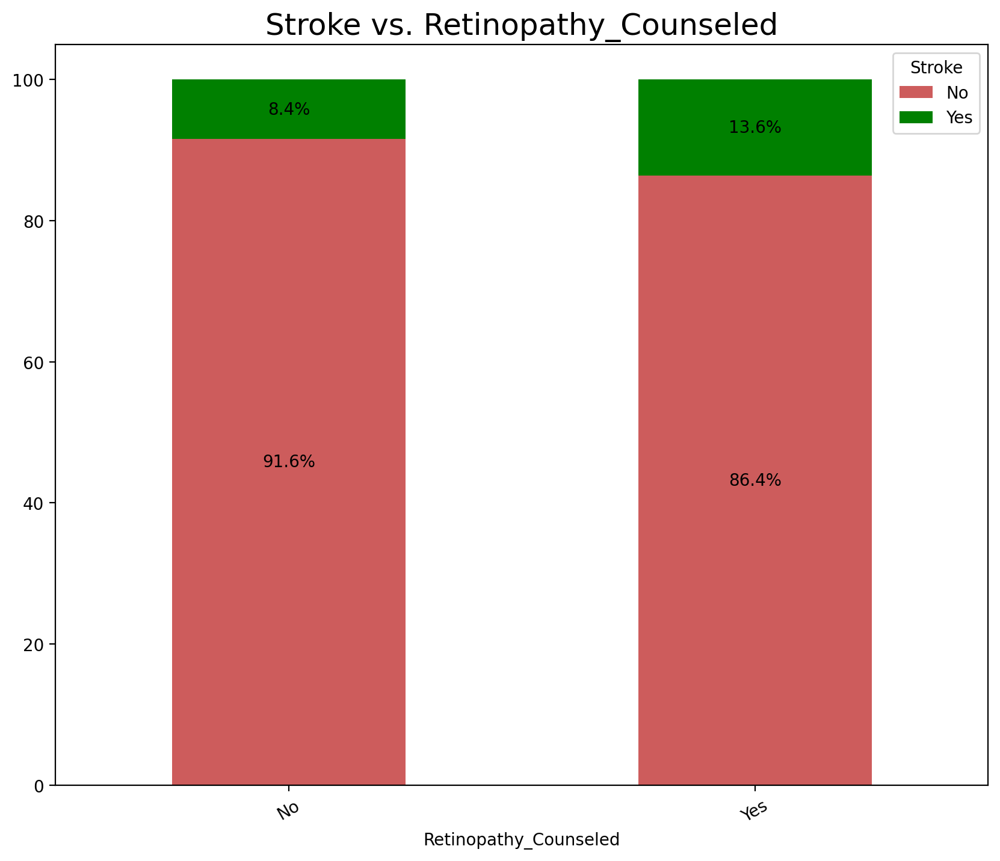

In [8]:
# Plot each disease with the numerical columns against all the other coumns in the dataset to explore it

def diseases_eda():
    for disease in diseases:
        for col in num_vars:
            print('\n\n')
            sns.kdeplot(data=df, x=col, hue=disease, common_norm=False, palette={'Yes':'royalblue', 'No':'darkorange'})\
                .set(title=f"{disease} vs. {col}\n(normalized)", xlabel=col, ylabel=None, yticklabels='')
            plt.tick_params(left=False)
            plt.show();
    
        for col in cat_vars:
            print('\n\n')
            fig, ax = plt.subplots()
            pd.crosstab(df[col], df[disease],  normalize='index').apply(lambda r: r*100)\
                .plot(kind="bar", stacked=True, color=['indianred','green'], ax=ax).set(title=f"{disease} vs. {col}")
            for c in ax.containers:
                ax.bar_label(c, fmt='%.1f%%', label_type='center')
            plt.xticks(rotation=30)
            plt.show();

diseases_eda()

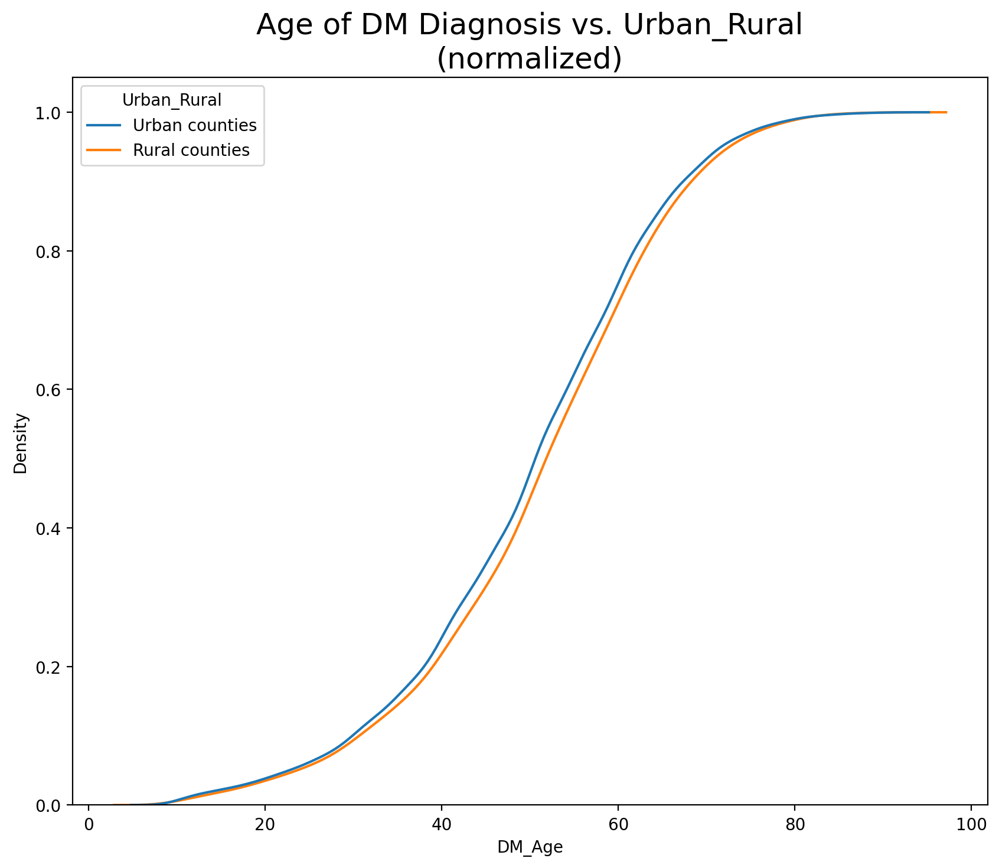

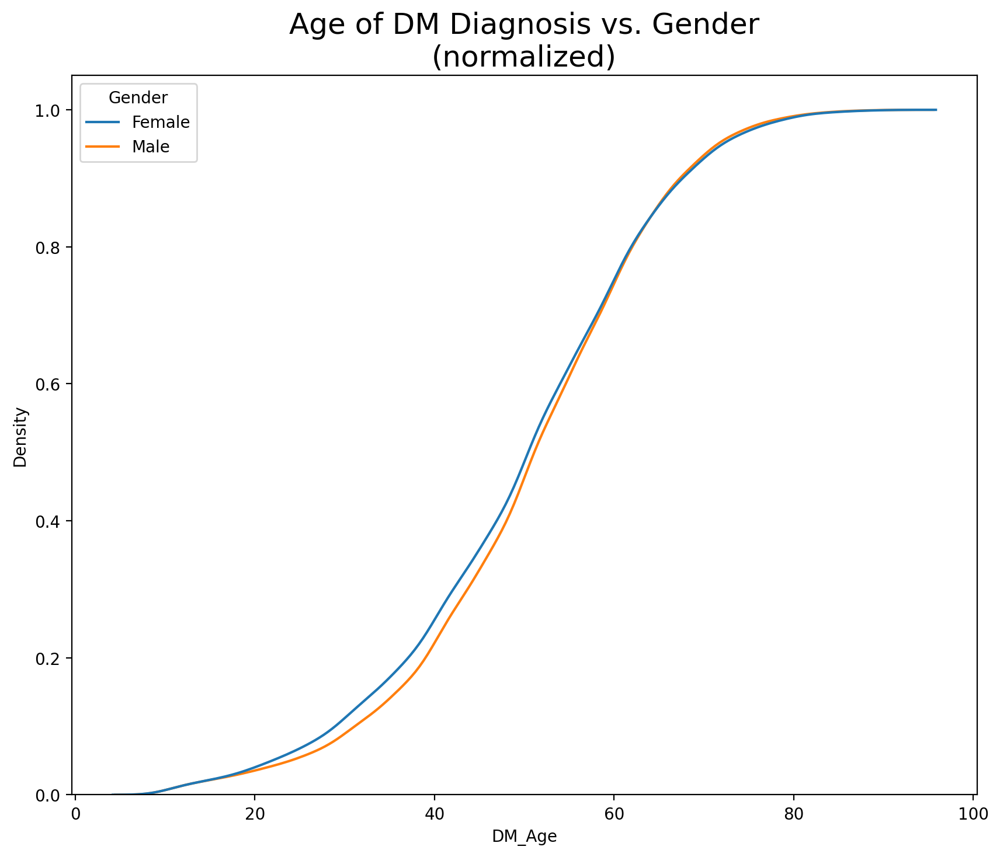

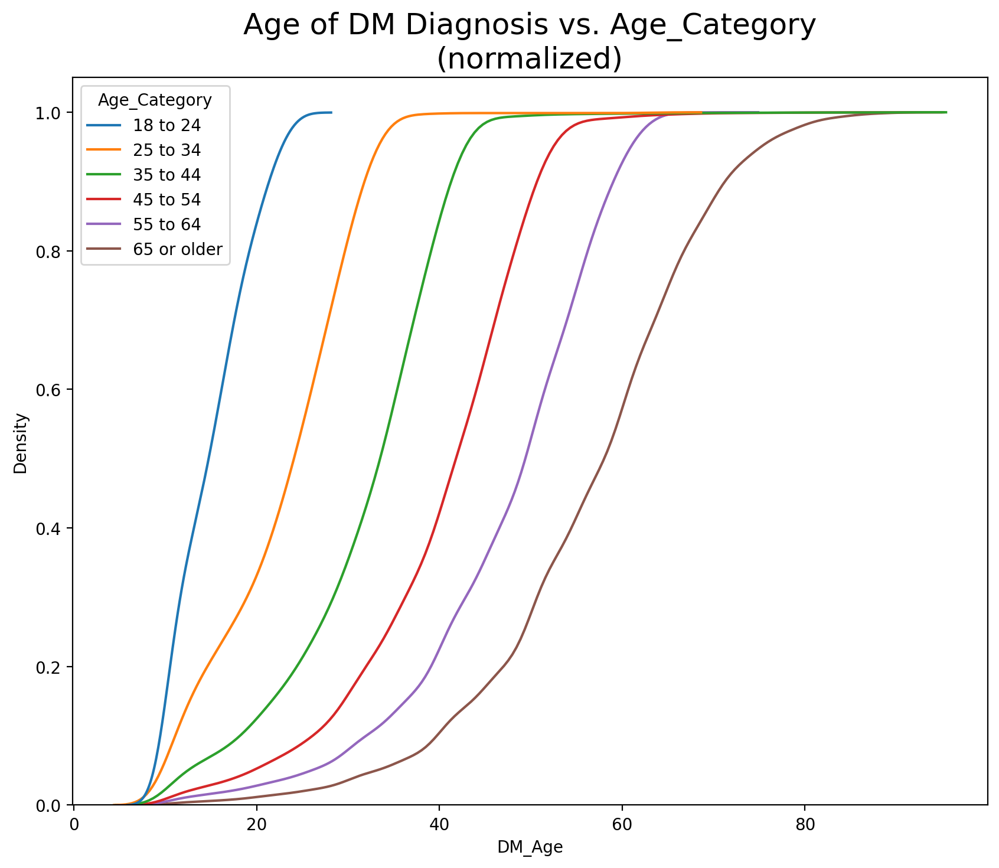

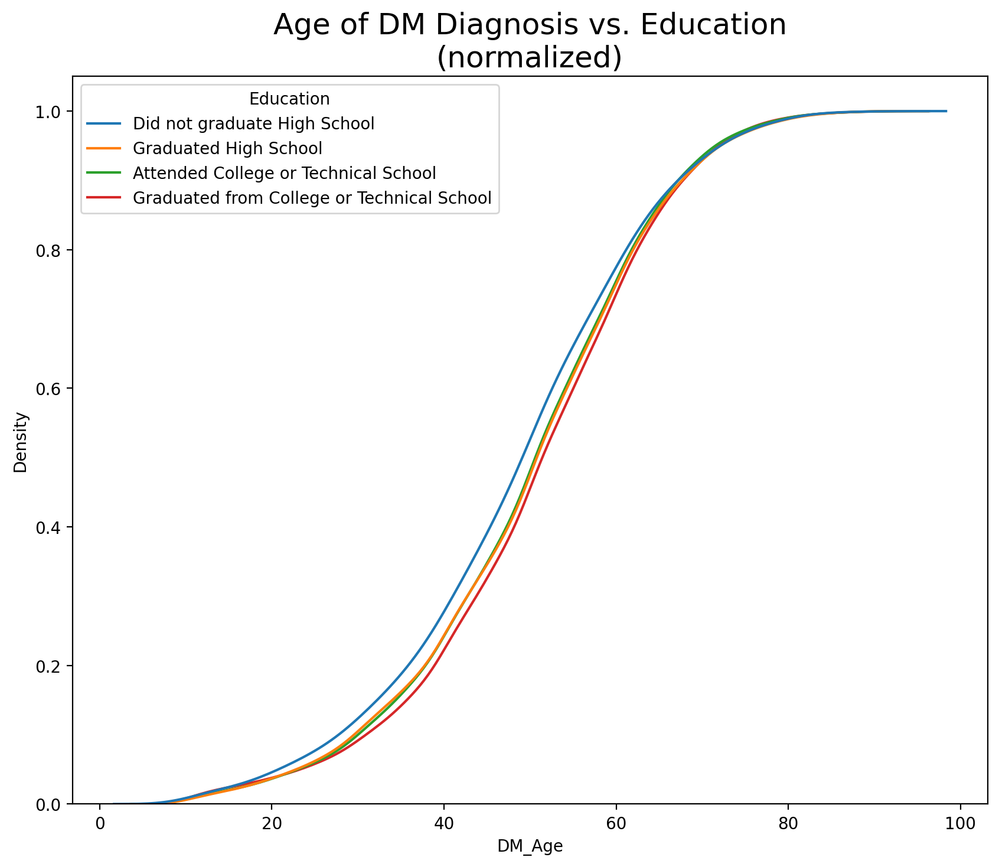

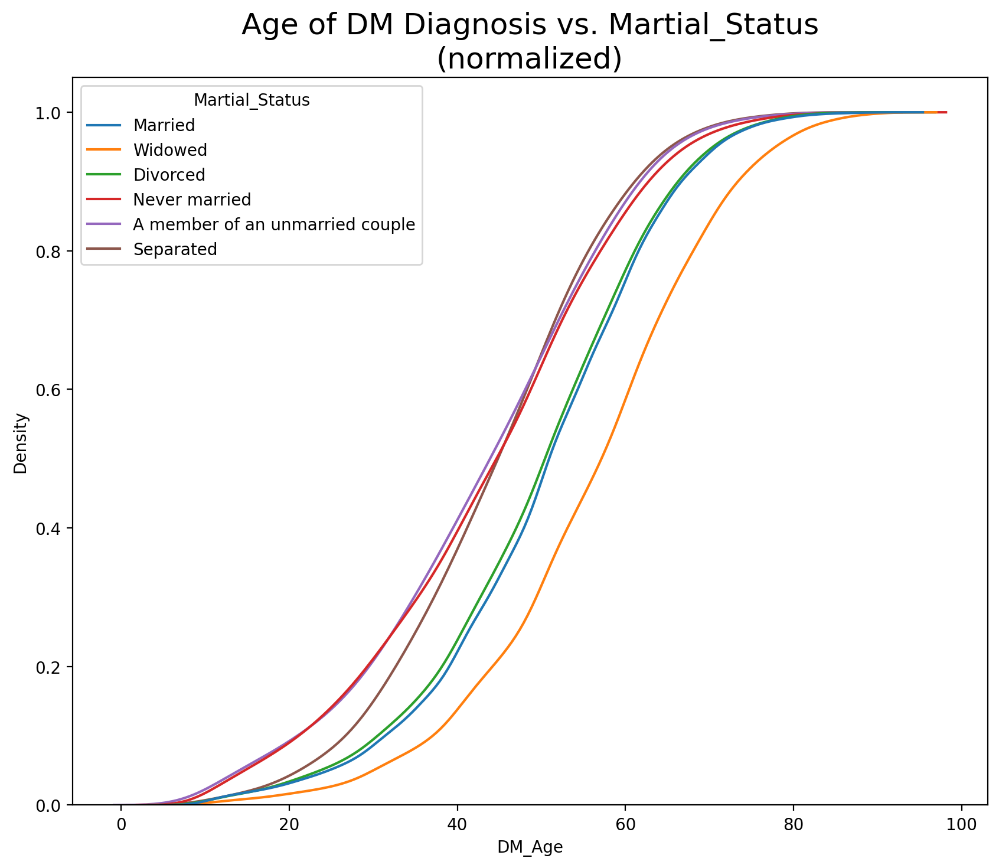

...

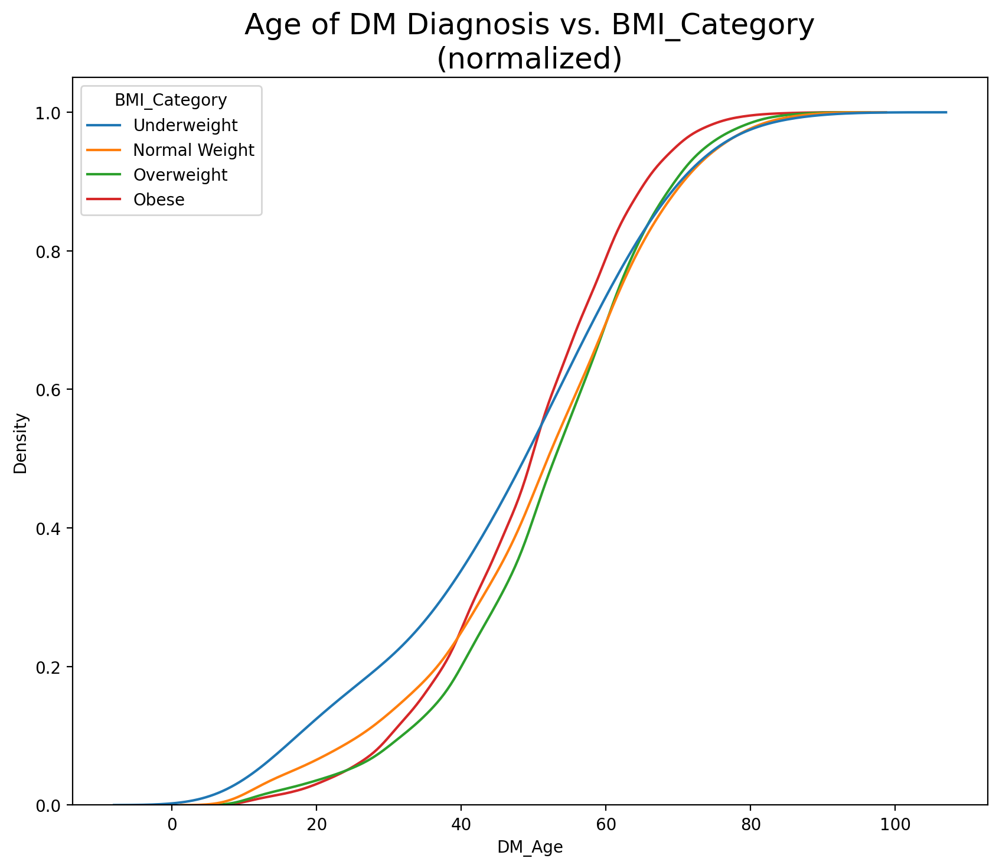

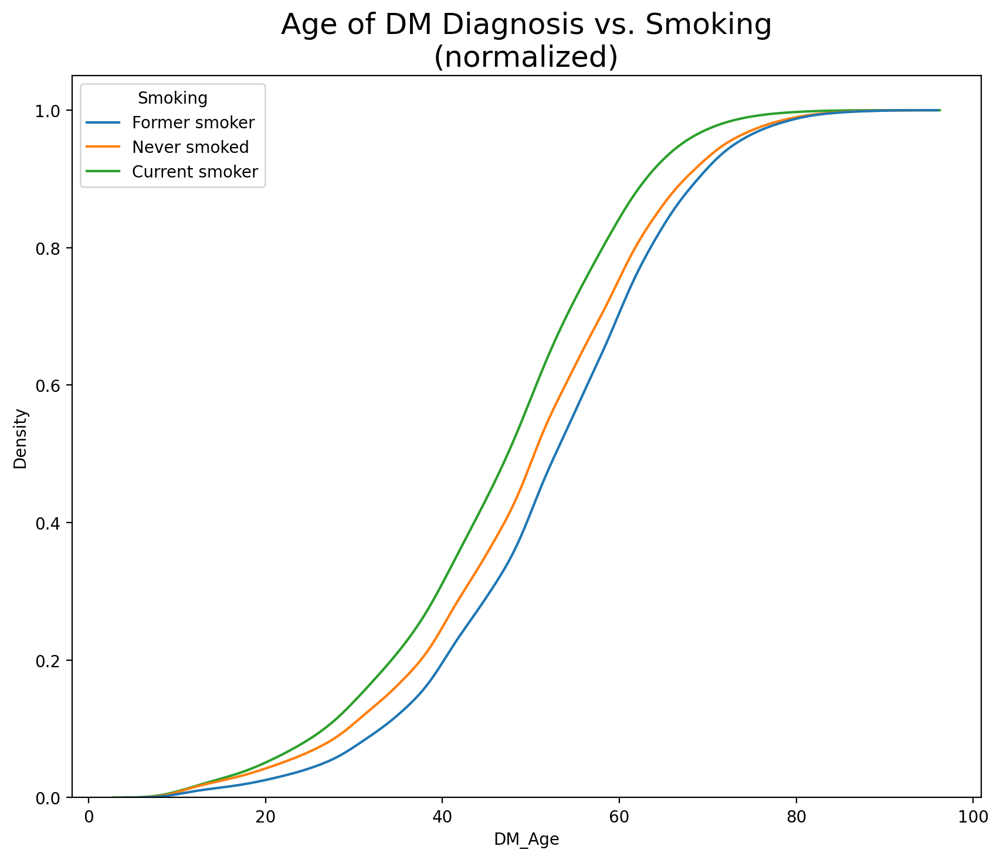

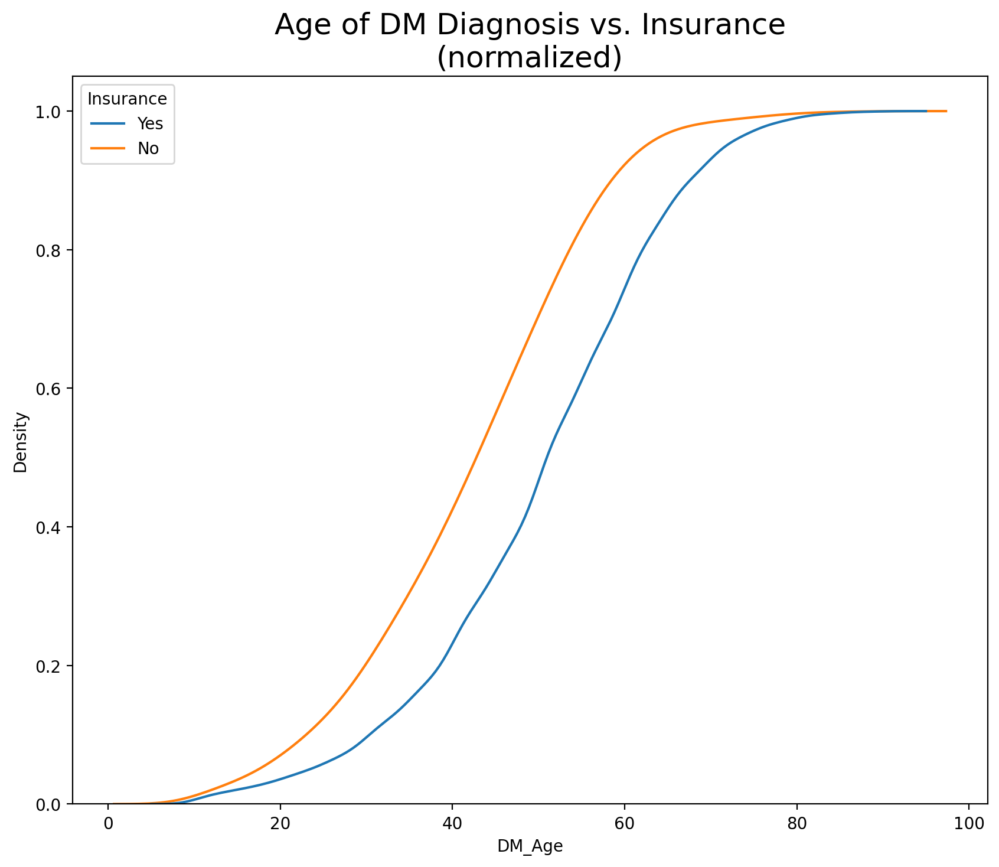

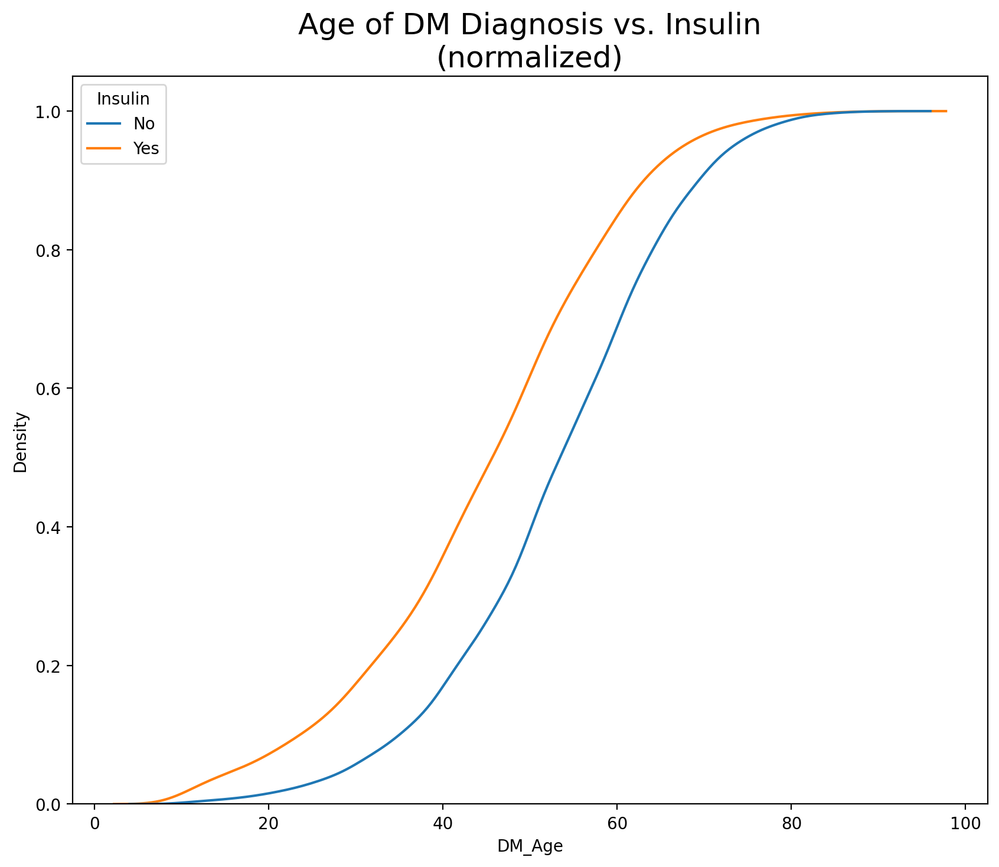

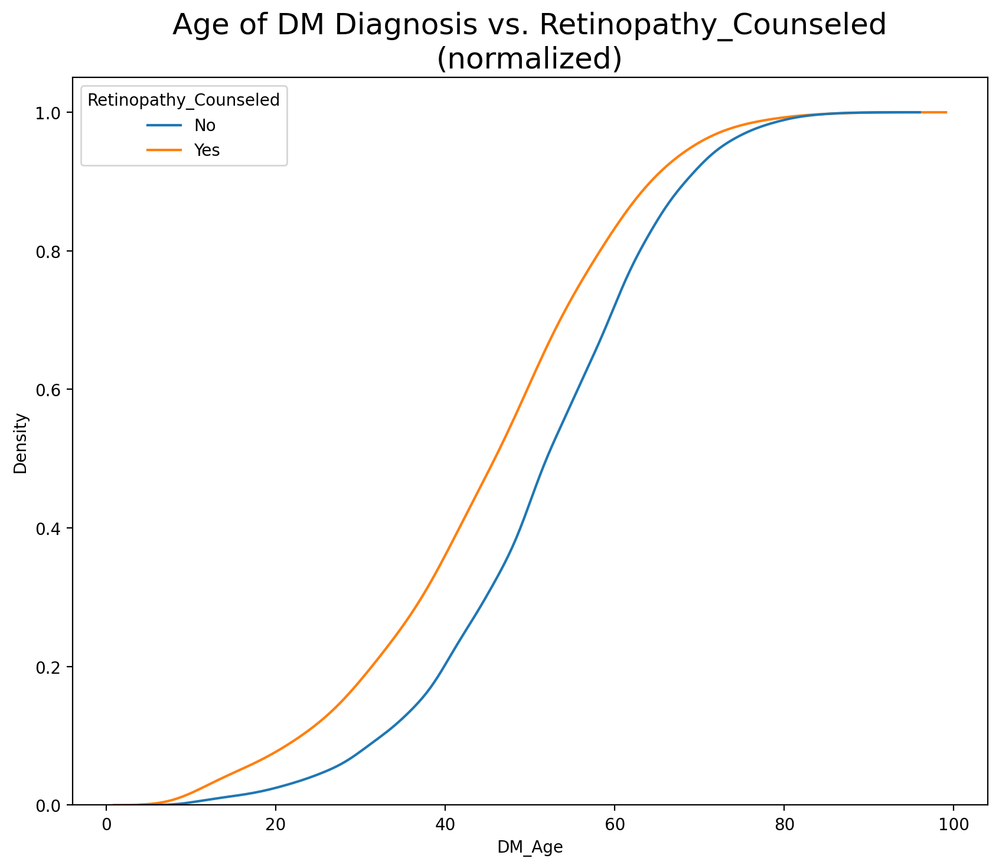

In [9]:
# Plot age of diagnosis of DM against categorical columns

for col in cat_vars:
    sns.kdeplot(data=df, x='DM_Age', hue=col, common_norm=False, cumulative=True)\
        .set(title=f"Age of DM Diagnosis vs. {col}\n(normalized)", xlabel='DM_Age')
    plt.show();

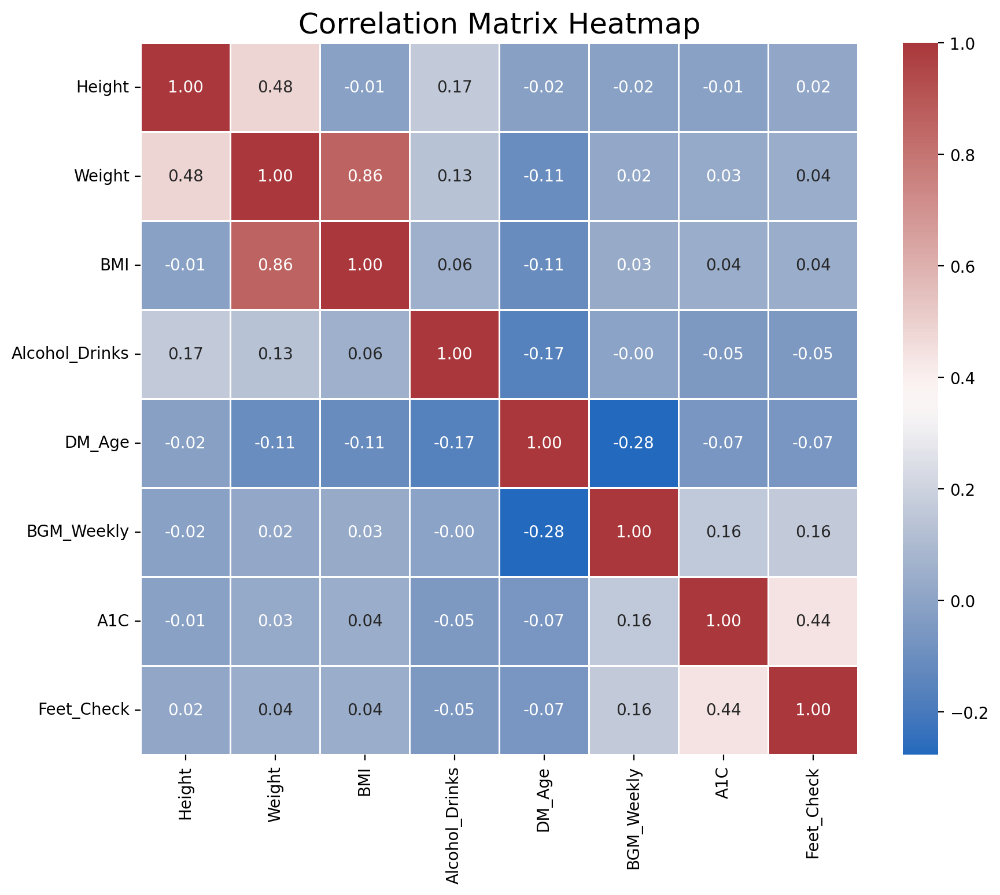

In [10]:
# Plot a correlation heatmap to spot any possible correlations

sns.heatmap(df.corr(), annot=True, linewidth=0.5, fmt='.2f', cmap='vlag')
plt.title('Correlation Matrix Heatmap')
plt.show()

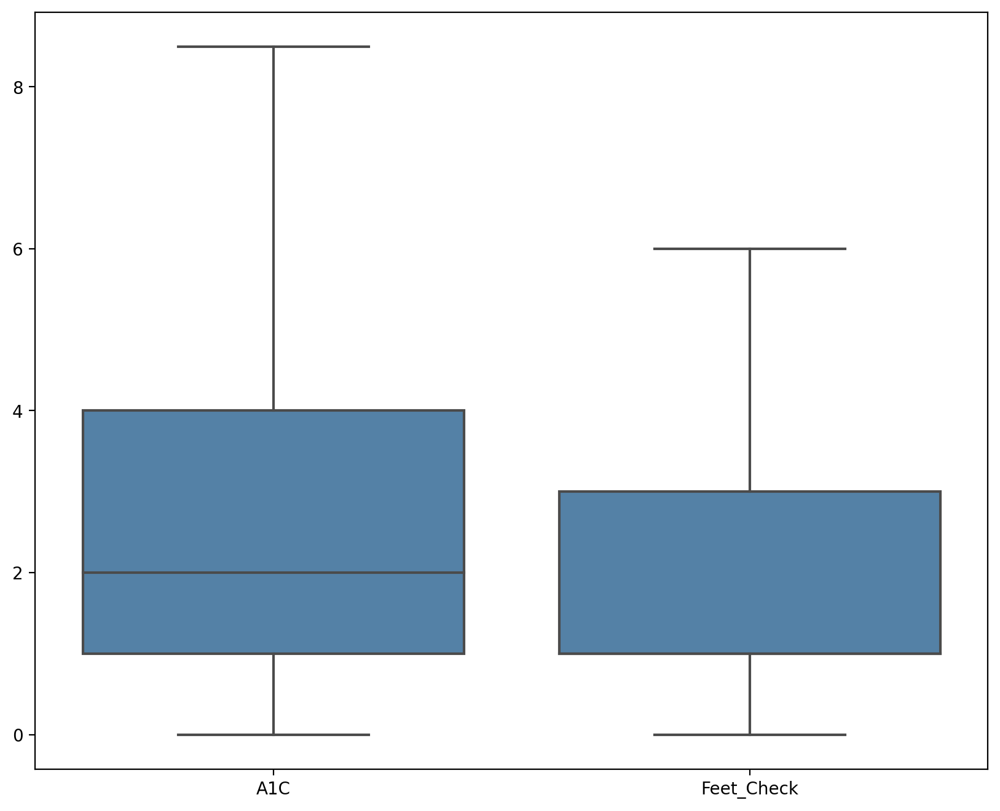

In [11]:
sns.boxplot(data=df[['A1C', 'Feet_Check']], showfliers=False, color='steelblue')
plt.show()

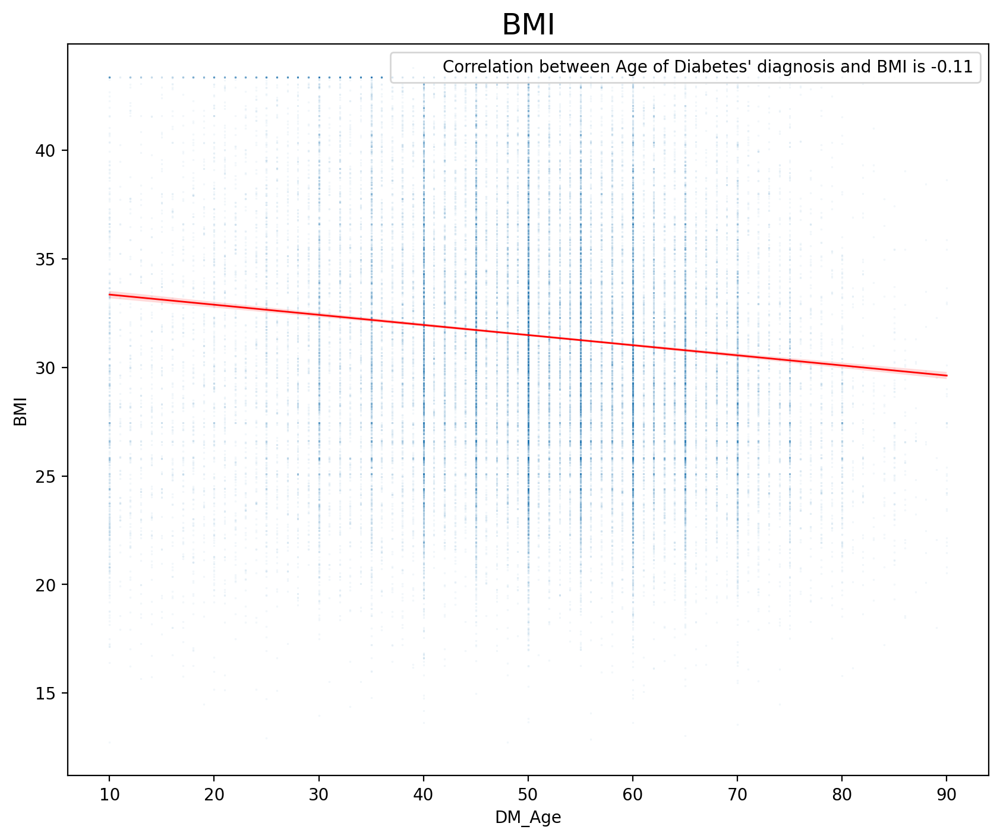

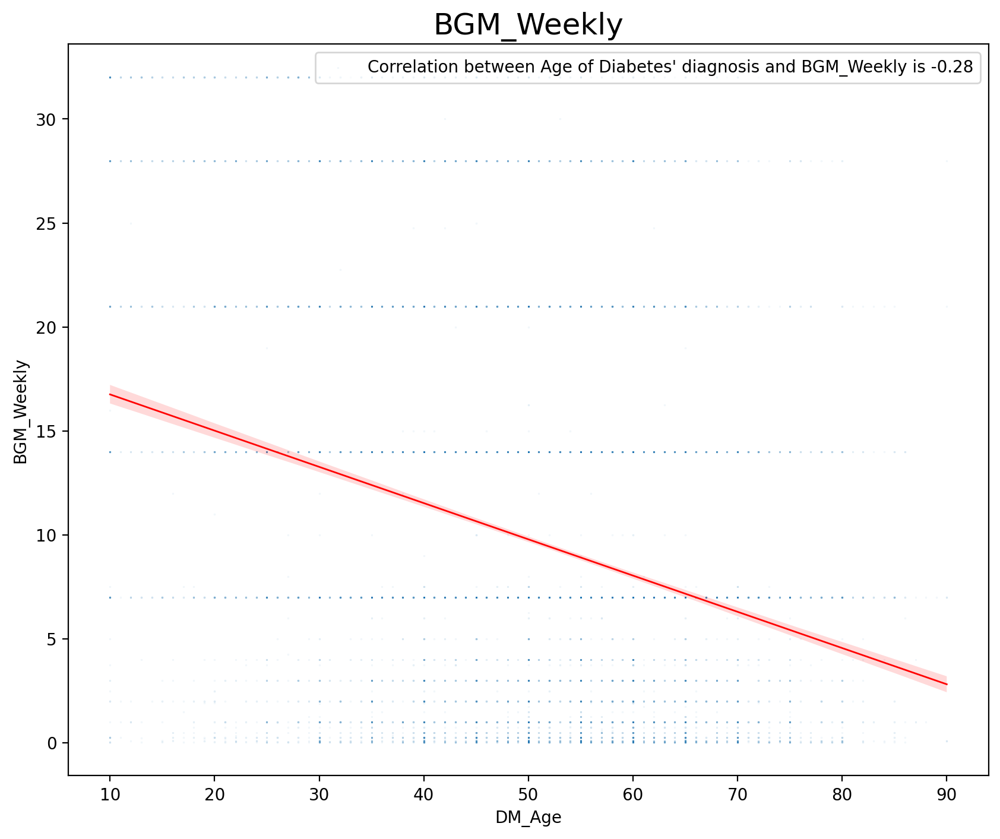

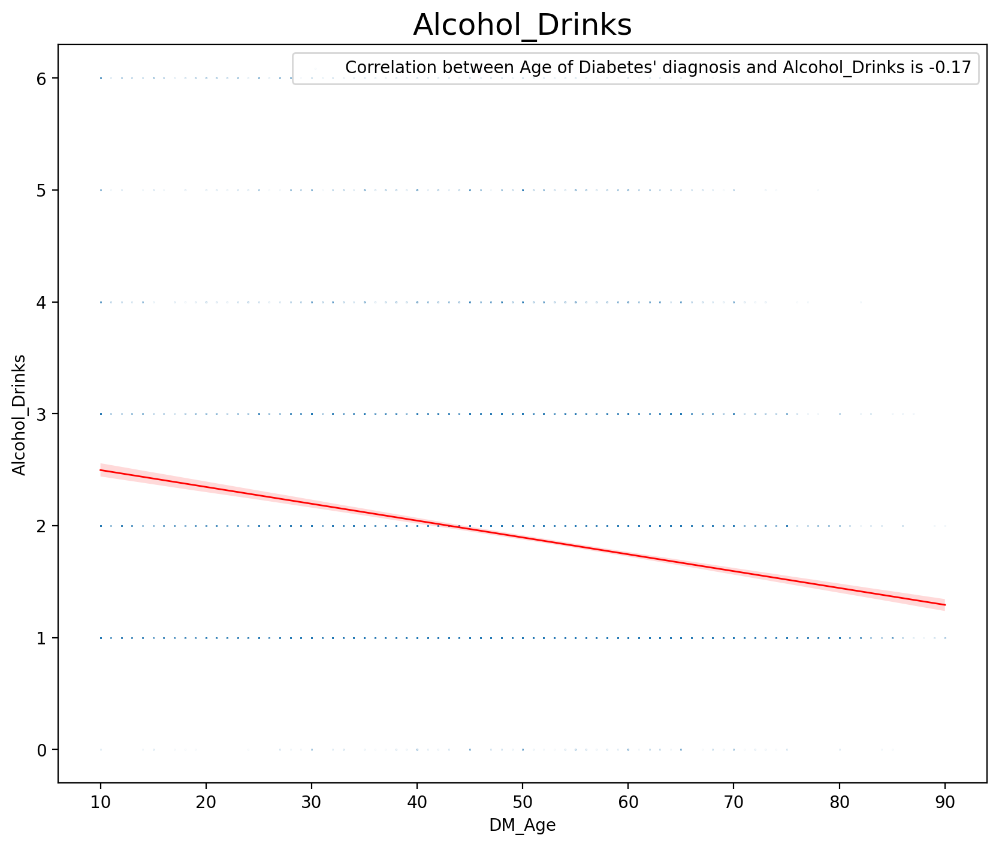

In [12]:
DM_Age_Regplot = ['BMI', 'BGM_Weekly', 'Alcohol_Drinks']

for col in DM_Age_Regplot:
    print('\n' + f'='*100 + '\n')
    sns.regplot(data=df, x='DM_Age', y=col, scatter_kws={'s':0.001}, line_kws={'lw':1, 'color':'red'}).set(title=f"{col}")
    plt.legend(loc='upper right', labels=[f"Correlation between Age of Diabetes' diagnosis and {col} is {round(df['DM_Age'].corr(df[col]), 2)}"])
    plt.show();

In [13]:
# Check to see the percentage of people to have each disease according to different variables

for disease in diseases:
    globals()["df_"+str(disease)] = df.dropna(subset=[disease]).copy()
    globals()["df_"+str(disease)][disease] = globals()["df_"+str(disease)][disease].str.get_dummies()['Yes']
    for col in cat_vars:
        values = globals()["df_"+str(disease)][col].dropna().unique()
        for v in values:
            print(f'The posibility of people who ({v} {col}) to have {disease} = {round(globals()["df_"+str(disease)][globals()["df_"+str(disease)][col] == v][disease].mean() * 100, 2)}%', end='\n\n')

The posibility of people who (Urban counties Urban_Rural) to have HTN = 39.6%

The posibility of people who (Rural counties Urban_Rural) to have HTN = 44.56%

The posibility of people who (Female Gender) to have HTN = 38.65%

The posibility of people who (Male Gender) to have HTN = 42.31%

The posibility of people who (65 or older Age_Category) to have HTN = 59.78%

The posibility of people who (55 to 64 Age_Category) to have HTN = 46.79%

The posibility of people who (45 to 54 Age_Category) to have HTN = 34.34%

The posibility of people who (18 to 24 Age_Category) to have HTN = 7.82%

The posibility of people who (25 to 34 Age_Category) to have HTN = 13.07%

The posibility of people who (35 to 44 Age_Category) to have HTN = 22.08%

The posibility of people who (Graduated High School Education) to have HTN = 44.02%

The posibility of people who (Graduated from College or Technical School Education) to have HTN = 36.22%

The posibility of people who (Did not graduate High School Educati

The posibility of people who ($50,000 to < $100,000 Income_Category) to have Asthma = 13.18%

The posibility of people who ($35,000 to < $50,000 Income_Category) to have Asthma = 13.95%

The posibility of people who (0 to $15,000 Income_Category) to have Asthma = 22.5%

The posibility of people who ($100,000 to < $200,000 Income_Category) to have Asthma = 13.04%

The posibility of people who ($200,000 or more Income_Category) to have Asthma = 12.07%

The posibility of people who (No Veteran) to have Asthma = 15.26%

The posibility of people who (Yes Veteran) to have Asthma = 9.87%

The posibility of people who (Underweight BMI_Category) to have Asthma = 13.57%

The posibility of people who (Overweight BMI_Category) to have Asthma = 12.5%

The posibility of people who (Obese BMI_Category) to have Asthma = 18.46%

The posibility of people who (Normal Weight BMI_Category) to have Asthma = 12.12%

The posibility of people who (Former smoker Smoking) to have Asthma = 14.55%

The posibility 

The posibility of people who (Urban counties Urban_Rural) to have Kidney_Disease = 4.07%

The posibility of people who (Rural counties Urban_Rural) to have Kidney_Disease = 4.2%

The posibility of people who (Female Gender) to have Kidney_Disease = 4.34%

The posibility of people who (Male Gender) to have Kidney_Disease = 3.78%

The posibility of people who (65 or older Age_Category) to have Kidney_Disease = 7.14%

The posibility of people who (55 to 64 Age_Category) to have Kidney_Disease = 4.05%

The posibility of people who (45 to 54 Age_Category) to have Kidney_Disease = 2.58%

The posibility of people who (18 to 24 Age_Category) to have Kidney_Disease = 0.63%

The posibility of people who (25 to 34 Age_Category) to have Kidney_Disease = 1.02%

The posibility of people who (35 to 44 Age_Category) to have Kidney_Disease = 1.59%

The posibility of people who (Graduated High School Education) to have Kidney_Disease = 4.31%

The posibility of people who (Graduated from College or Techn

The posibility of people who (Attended College or Technical School Education) to have MI = 5.77%

The posibility of people who (Married Martial_Status) to have MI = 5.07%

The posibility of people who (Widowed Martial_Status) to have MI = 10.79%

The posibility of people who (Divorced Martial_Status) to have MI = 7.43%

The posibility of people who (Never married Martial_Status) to have MI = 2.45%

The posibility of people who (A member of an unmarried couple Martial_Status) to have MI = 2.62%

The posibility of people who (Separated Martial_Status) to have MI = 6.87%

The posibility of people who ($25,000 to < $35,000 Income_Category) to have MI = 7.13%

The posibility of people who ($15,000 to < $25,000 Income_Category) to have MI = 9.13%

The posibility of people who ($50,000 to < $100,000 Income_Category) to have MI = 4.32%

The posibility of people who ($35,000 to < $50,000 Income_Category) to have MI = 5.81%

The posibility of people who (0 to $15,000 Income_Category) to have MI 

The posibility of people who (Never smoked Smoking) to have Stroke = 3.16%

The posibility of people who (Current smoker Smoking) to have Stroke = 5.78%

The posibility of people who (Yes Insurance) to have Stroke = 4.22%

The posibility of people who (No Insurance) to have Stroke = 2.09%

The posibility of people who (No Insulin) to have Stroke = 8.2%

The posibility of people who (Yes Insulin) to have Stroke = 11.94%

The posibility of people who (No Retinopathy_Counseled) to have Stroke = 8.4%

The posibility of people who (Yes Retinopathy_Counseled) to have Stroke = 13.63%



# Insights found in this project:<br>

- __HTN:__
    - Factors that seems to increase the probability of being diagnosed with hypertension include: BMI, living in rural area, male gender, less education, less income, being a veteran or former veteran, being a smoker or former smoker, having insurance.
     - Having insurance does not make sense to be a cause for having hypertension. Rather, it makes more sense that some patients with no insurance have undiagnosed hypertension due to the lack of care they might have, which puts them at risk for cardiovascular complications. 
     - As for veterans, combat exposure increases hypertension risk.
<br><br>
- __MI & CHD:__
    - Veterans seems to have almost 2.5 folds more probability to have cardiovascular complications than general population.
<br><br>
- __DM:__
    - Factors that seems to increase the probability of being diagnosed with diabetes include: BMI, living in rural area, male gender, less education, less income, being a veteran or former veteran, being a smoker or former smoker, having insurance.
<br><br>
- __Asthma & COPD:__
     - Asthma is more prevalent in urban areas, while COPD is more prevalent in rural areas.
     - Veterans are more likely to develop COPD.
<br><br>
- __Arthritis:__
    - Factors that seems to increase the probability of being diagnosed with diabetes include: BMI, living in rural area, female gender, having insurance.
    - (almost double)
<br><br>
- __Veterans__:
    - Veterans have an overall rates of hypertension, diabetes, COPD, arthritis, and cardiovascular complications.
<br><br>
- __Insurance:__
    - Having insurance seems to increase the probability of being diagnosed with hypertension, diabetes, or arthritis.
    - This is more likely because patients with no insurance may have undiagnosed diseases due to the lack of healthcare they received, which puts them at risk for further complications. 
<br><br>
- __Age of Diabetes Diagnosis:__
    - Females tend to get diagnosed with DM at slightly lower age compared to males.
    - People who have not graduated from high school tend to get diagnosed with DM at slightly lower age compared to people with higher education. More data is needed to assess other confounding factors that affect this relationship.
    - Veterans tend to be diagnosed with DM at considerably higher age, which could be related to better physical health of veterans.
    - Even though people who do not have insurance have lower chances to get diagnosed with diabetes, but those who do get diagnosed usually do so at lower age, this could be due to the lack of healthcare they could have received with a health insurance, which leads to developing DM at lower age.
    - Patients who get diagnosed with Diabetes at lower age measure their blood glucose at higher rate. Correlation between diagnosis age of DM and number of weekly blood glucose measurements is -0.28, which is weak positive correlation. This could be an indication of better patient counseling given to younger patients, especially those with type-1 DM. Unfortunately, more data is needed for further evaluation.
<br><br>
- __Rural areas:__
    - Rural areas have more prevalence for most diseases surveyed, especially cardiovascular-related diseases. This could be because rural residents often encounter barriers to healthcare that limit their ability to obtain the care they need.
    - The only exceptions were Asthma and Depression. Both of them were more common in Urban areas.
<br><br>
- __Gender:__
    - Males have slightly higher rates of hypertension, with considerably higher chances of cardiovascular complications like Myocardial Infarctions and Congestive Heart Diseases.
    - Females have higher chances of being diagnosed with Depression and with Arthritis compared to males.
<br><br>
- __Other Insights:__
    - Older people tend to have lower chances of being diagnosed with depression.
    - Married people have significantly lower chances of being diagnosed with depression compared to people with other martial status.
    - Those who have completed their college or technical school seems to be less likely to be diagnosed with any of the diseases mentioned in this survey. This is more likely due to the increases health awareness they possess due to their education.
    - As income increases, chances of being diagnosed with any of the diseases mentioned in this survey decreases. This is likely due to the better healthcare they receive which cost more money.
    - Obese people generally have higher chances of being diagnosed with any of the diseases mentioned in this survey.
    - Those who never smoked have significantly lower chances of being diagnosed with any of the diseases mentioned in this survey compared to both current and former smokers. The difference in COPD is staggering.